In [22]:
import torch
import torchvision.transforms as transforms
from torchvision.datasets import MNIST
import matplotlib.pyplot as plt
import numpy as np
import os

In [23]:
# Load MNIST dataset
transform = transforms.Compose([
    transforms.Resize((28, 28)),
    transforms.ToTensor()
])
dataset = MNIST(root="./data", train=True, download=True, transform=transform)

In [25]:
def get_random_matrix(size=2):
    """Returns images (inverted) and numeric labels for a size×size random MNIST matrix."""
    indices = torch.randint(0, len(dataset), (size, size))
    matrix_images = [[1 - dataset[i][0].squeeze(0).numpy() for i in row] for row in indices]
    matrix_values = [[dataset[i][1] for i in row] for row in indices]
    return matrix_images, matrix_values

def draw_bracket(ax, x, y_bottom, y_top, side='left', bracket_width=10, linewidth=3):
    """
    Draws a single bracket at x (vertical line from y_bottom to y_top,
    plus horizontal lines at top and bottom).
    side='left' draws a bracket oriented like [ ; side='right' draws ].
    """
    if side == 'left':
        # top line goes from (x+bracket_width, y_top) to (x, y_top)
        # vertical line from (x, y_top) to (x, y_bottom)
        # bottom line from (x, y_bottom) to (x+bracket_width, y_bottom)
        lines = [
            ((x+bracket_width, y_top),   (x, y_top)),
            ((x, y_top),                 (x, y_bottom)),
            ((x, y_bottom),              (x+bracket_width, y_bottom))
        ]
    else:
        # This is the "mirrored" bracket
        lines = [
            ((x-bracket_width, y_top),   (x, y_top)),
            ((x, y_top),                 (x, y_bottom)),
            ((x, y_bottom),              (x-bracket_width, y_bottom))
        ]
    # Add each line to the plot
    for (start, end) in lines:
        ax.add_line(plt.Line2D([start[0], end[0]],
                               [start[1], end[1]],
                               color='black', linewidth=linewidth))

def plot_matrices(A_images, B_images, save_path=None):
    size = len(A_images)

    # Adjustable parameters
    cell_size     = 28   # MNIST digit is 28×28
    cell_spacing  = 8    # gap between columns/rows within each matrix
    matrix_gap    = 40   # gap between Matrix A and Matrix B
    bracket_width = 10   # how far brackets extend horizontally
    bracket_lw    = 3    # line thickness for the brackets

    fig, ax = plt.subplots(figsize=(size*3, size*3))
    ax.axis('off')

    # A helper to get the (left, right, bottom, top) extent for each digit
    def cell_extent(row, col, x_offset=0):
        left   = col * (cell_size + cell_spacing) + x_offset
        right  = left + cell_size
        top    = -row * (cell_size + cell_spacing)
        bottom = top - cell_size
        return (left, right, bottom, top)

    # Overall width/height of one matrix
    matrix_width  = size * (cell_size + cell_spacing) - cell_spacing
    matrix_height = size * (cell_size + cell_spacing) - cell_spacing

    # --- Plot Matrix A ---
    for i in range(size):
        for j in range(size):
            ax.imshow(A_images[i][j], cmap='gray', origin='upper',
                      extent=cell_extent(i, j, x_offset=0))

    # --- Plot Matrix B ---
    x_offset_B = matrix_width + matrix_gap
    for i in range(size):
        for j in range(size):
            ax.imshow(B_images[i][j], cmap='gray', origin='upper',
                      extent=cell_extent(i, j, x_offset=x_offset_B))

    # --- Draw brackets around Matrix A ---
    # Matrix A spans x from 0 to matrix_width, y from -matrix_height to 0
    # So we can bracket at x=-10 and x=matrix_width+10, from y_bottom = -matrix_height to y_top = 0
    y_top_A = 0
    y_bot_A = -matrix_height
    draw_bracket(ax, x=-10,
                 y_bottom=y_bot_A, y_top=y_top_A,
                 side='left', bracket_width=bracket_width, linewidth=bracket_lw)
    draw_bracket(ax, x=matrix_width+10,
                 y_bottom=y_bot_A, y_top=y_top_A,
                 side='right', bracket_width=bracket_width, linewidth=bracket_lw)

    # --- Draw brackets around Matrix B ---
    # Matrix B spans x from x_offset_B to x_offset_B + matrix_width
    # So bracket it at x_offset_B - 10 and x_offset_B + matrix_width + 10
    y_top_B = 0
    y_bot_B = -matrix_height
    draw_bracket(ax, x=x_offset_B-10,
                 y_bottom=y_bot_B, y_top=y_top_B,
                 side='left', bracket_width=bracket_width, linewidth=bracket_lw)
    draw_bracket(ax, x=x_offset_B+matrix_width+10,
                 y_bottom=y_bot_B, y_top=y_top_B,
                 side='right', bracket_width=bracket_width, linewidth=bracket_lw)

    # Let Matplotlib fit everything.
    ax.autoscale()

    # If we have a file path to save to, do it before showing.
    if save_path is not None:
        plt.savefig(save_path, dpi=300, bbox_inches="tight")

    plt.show()

def save_matrix_data(set_name, num_samples, size):
    """Generate, plot, and save matrix multiplication data along with operand matrices in a single file."""
    os.makedirs(f"dataset/{set_name}/images", exist_ok=True)
    os.makedirs(f"dataset/{set_name}/matrices", exist_ok=True)  # Folder for storing matrices

    A_matrices = []
    B_matrices = []
    labels = []

    for i in range(num_samples):
        A_images, A_values = get_random_matrix(size)
        B_images, B_values = get_random_matrix(size)

        # Convert lists to numpy arrays
        A_values_np = np.array(A_values)
        B_values_np = np.array(B_values)

        # Compute ground truth
        ground_truth = np.matmul(A_values_np, B_values_np)

        # Save images
        img_path = f"dataset/{set_name}/images/{size}x{size}_{i}.png"
        plot_matrices(A_images, B_images, save_path=img_path)

        # Store operand matrices and labels
        A_matrices.append(A_values_np)
        B_matrices.append(B_values_np)
        labels.append(ground_truth)

    # Convert lists to numpy arrays and save them as single files
    np.save(f"dataset/{set_name}/matrices/A_{size}x{size}.npy", np.array(A_matrices))
    np.save(f"dataset/{set_name}/matrices/B_{size}x{size}.npy", np.array(B_matrices))
    np.save(f"dataset/{set_name}/labels_{size}x{size}.npy", np.array(labels))

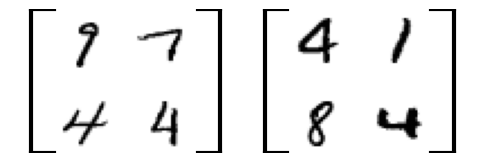

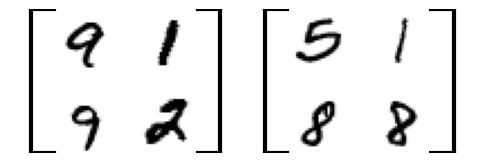

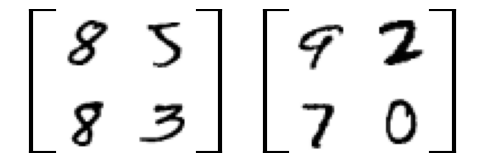

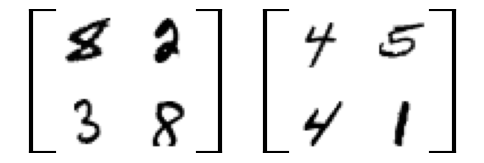

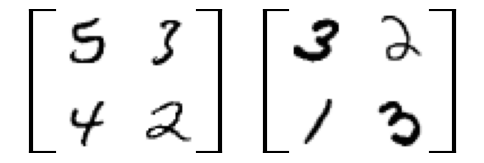

...

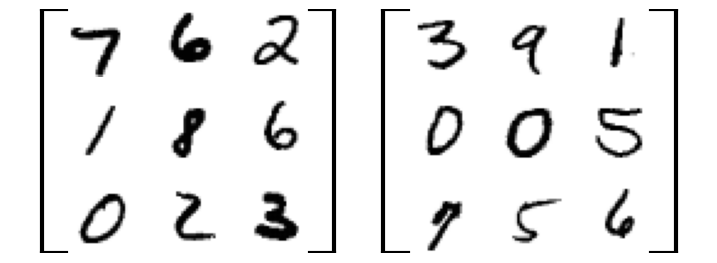

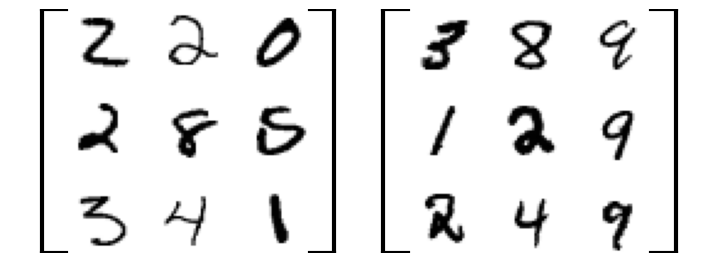

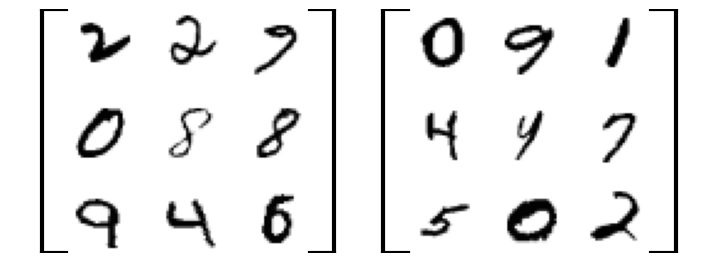

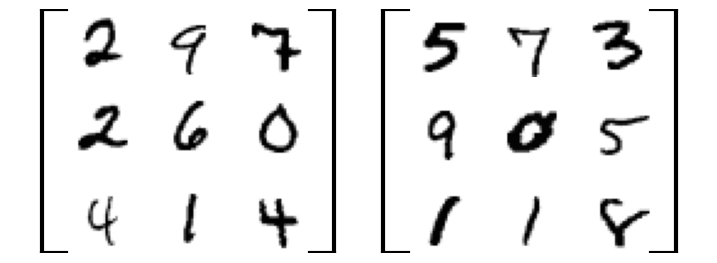

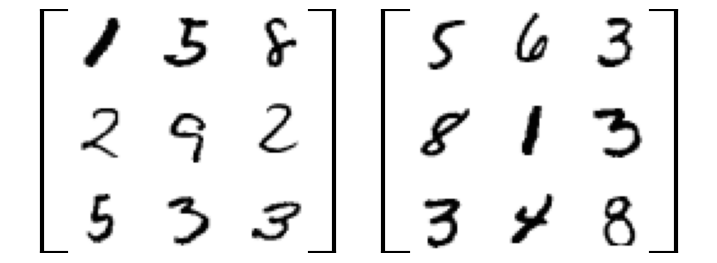

Dataset generation complete!


In [26]:
# Generate dataset
sizes = [2, 3]
dataset_splits = {"train": 400, "val": 50, "test": 50}

for split, num_samples in dataset_splits.items():
    for size in sizes:
        save_matrix_data(split, num_samples, size)

print("Dataset generation complete!")

In [27]:
!zip -r /content/dataset.zip /content/dataset/

  adding: content/dataset/ (stored 0%)
  adding: content/dataset/train/ (stored 0%)
  adding: content/dataset/train/labels_2x2.npy (deflated 81%)
  adding: content/dataset/train/labels_3x3.npy (deflated 80%)
  adding: content/dataset/train/matrices/ (stored 0%)
  adding: content/dataset/train/matrices/B_2x2.npy (deflated 89%)
  adding: content/dataset/train/matrices/B_3x3.npy (deflated 90%)
  adding: content/dataset/train/matrices/A_2x2.npy (deflated 89%)
  adding: content/dataset/train/matrices/A_3x3.npy (deflated 90%)
  adding: content/dataset/train/images/ (stored 0%)
  adding: content/dataset/train/images/2x2_144.png (deflated 38%)
  adding: content/dataset/train/images/3x3_174.png (deflated 41%)
  adding: content/dataset/train/images/2x2_248.png (deflated 39%)
  adding: content/dataset/train/images/3x3_216.png (deflated 40%)
  adding: content/dataset/train/images/3x3_356.png (deflated 42%)
  adding: content/dataset/train/images/2x2_290.png (deflated 36%)
  adding: content/dataset/

In [28]:
from google.colab import files
files.download("/content/dataset.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [29]:
dataA = np.load("/content/dataset/train/matrices/A_2x2.npy")
print(dataA)

[[[9 7]
  [4 4]]

 [[9 1]
  [9 2]]

 [[8 5]
  [8 3]]

 ...

 [[1 3]
  [4 8]]

 [[1 0]
  [0 2]]

 [[2 7]
  [1 2]]]


In [30]:
dataB = np.load("/content/dataset/train/matrices/B_2x2.npy")
print(dataB)

[[[4 1]
  [8 4]]

 [[5 1]
  [8 8]]

 [[9 2]
  [7 0]]

 ...

 [[8 1]
  [3 1]]

 [[4 3]
  [5 0]]

 [[2 5]
  [1 0]]]


In [31]:
dataC = np.load("/content/dataset/train/labels_2x2.npy")
print(dataC)

[[[ 92  37]
  [ 48  20]]

 [[ 53  17]
  [ 61  25]]

 [[107  16]
  [ 93  16]]

 ...

 [[ 17   4]
  [ 56  12]]

 [[  4   3]
  [ 10   0]]

 [[ 11  10]
  [  4   5]]]
